In [46]:
!pip install mne-icalabel

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.6/21.6 MB 9.8 MB/s eta 0:00:00:00:010:01m


In [47]:
import mne
import matplotlib.pyplot as plt
from mne_icalabel import label_components

In [70]:
raw = mne.io.read_raw_eeglab('/kaggle/input/tempdata/p1_import.set', preload=True)

Reading /kaggle/input/tempdata/p1_import.fdt
Reading 0 ... 159096  =      0.000 ...   636.384 secs...


In [71]:
dir(raw)

['__class__',
 '__contains__',
 '__del__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__enter__',
 '__eq__',
 '__exit__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getitem__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__len__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setitem__',
 '__sizeof__',
 '__slotnames__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_annotations',
 '_cals',
 '_check_bad_segment',
 '_comp',
 '_cropped_samp',
 '_data',
 '_dtype',
 '_dtype_',
 '_extra_attributes',
 '_filenames',
 '_first_samps',
 '_first_time',
 '_get_buffer_size',
 '_get_channel_positions',
 '_get_duration_string',
 '_getitem',
 '_handle_tmin_tmax',
 '_init_kwargs',
 '_last_samps',
 '_last_time',
 '_orig_units',
 '_parse_get_set_params',
 '_pick_drop_channels',
 '_pick_projs',
 '_preload_data',
 '_projector',
 '_raw_extras',
 '_raw_lengths',
 '_read_co

In [72]:
eeg_channels = raw.ch_names

In [73]:

eeg_raw=raw.pick(mne.pick_channels(raw.info['ch_names'], include=raw.ch_names))

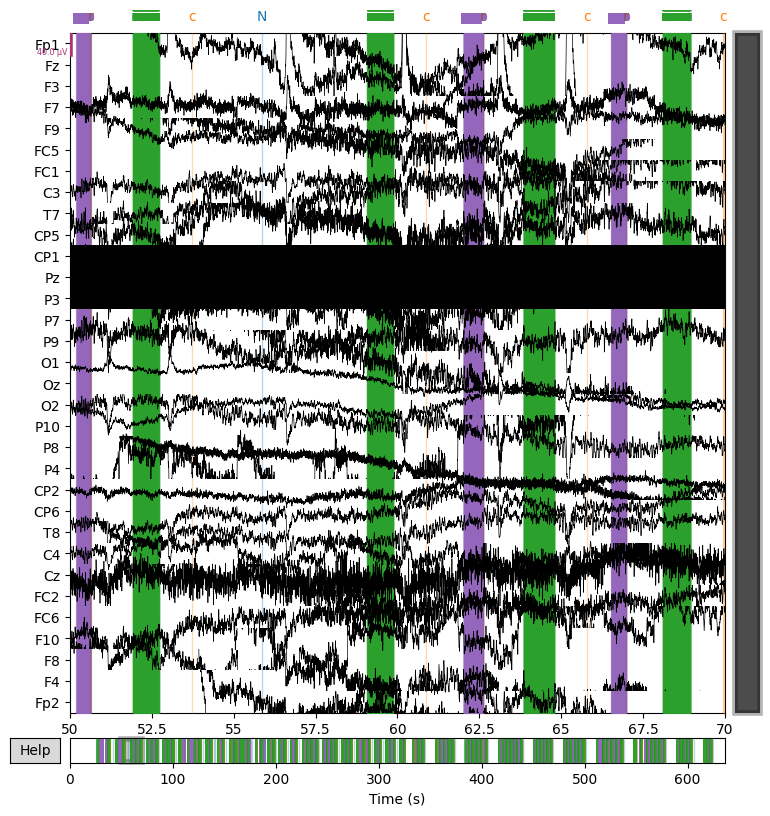

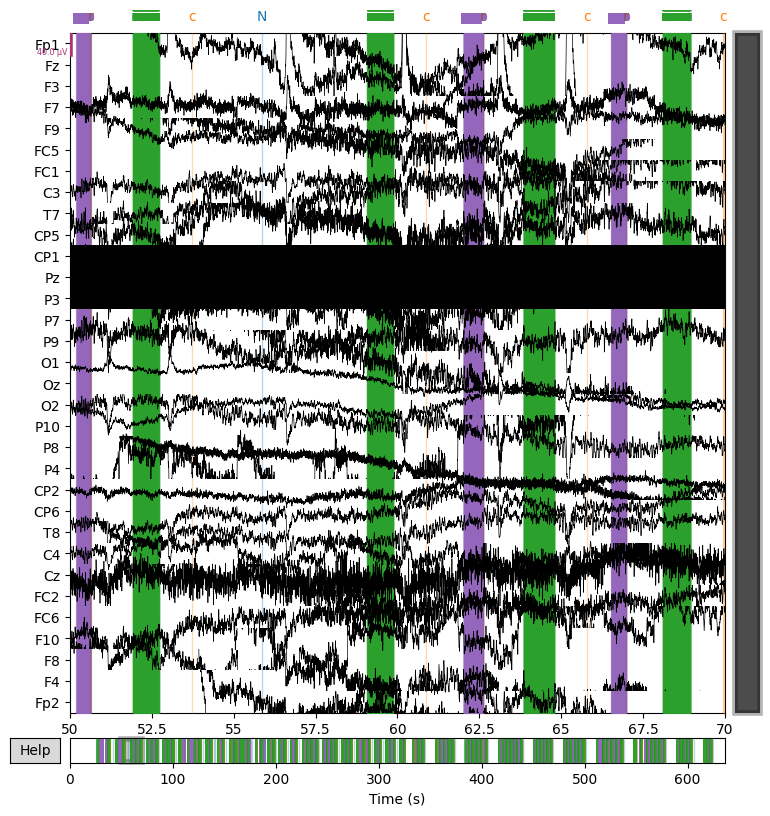

In [36]:
eeg_raw.plot(n_channels = 32, start = 50, duration=20)

In [32]:
# Select channels around motor cortex then only it will be wise to conclude presence of reward signals
# Do ICA to remove artifacts - eye and muscle
# Apply Filters especially @50 Hz and trim down from 40 Hz maybe

In [33]:
montage = mne.channels.make_standard_montage('standard_1020')
eeg_raw.set_montage(montage)

<RawEEGLAB | p1_import.fdt, 32 x 159097 (636.4 s), ~38.9 MiB, data loaded>

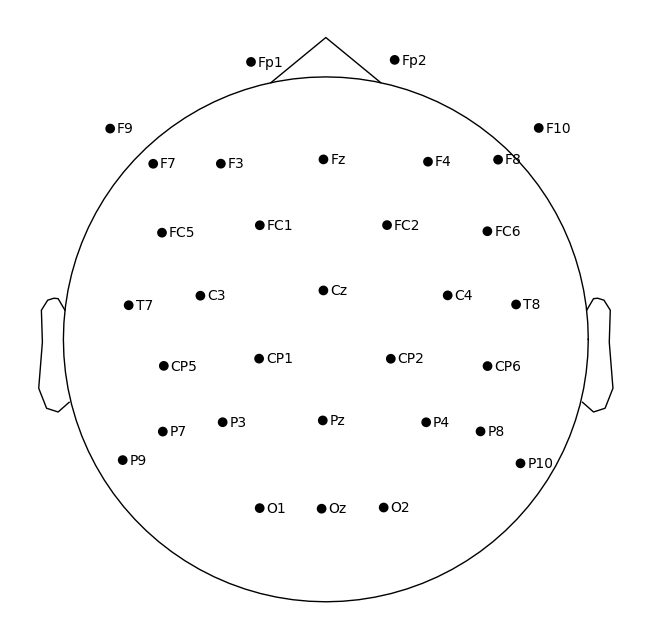

Figure(640x640)


In [34]:
print(eeg_raw.plot_sensors(show_names = True))

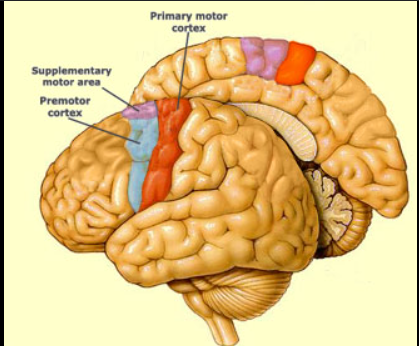


I would not need parietal and occipital, and frontal channels


In [75]:
eeg_raw.notch_filter(50)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1651 samples (6.604 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  32 out of  32 | elapsed:    0.2s finished


<RawEEGLAB | p1_import.fdt, 32 x 159097 (636.4 s), ~38.9 MiB, data loaded>

In [76]:
eeg_raw.filter(l_freq = 1, h_freq = 45)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 45 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 45.00 Hz
- Upper transition bandwidth: 11.25 Hz (-6 dB cutoff frequency: 50.62 Hz)
- Filter length: 825 samples (3.300 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  32 out of  32 | elapsed:    0.2s finished


<RawEEGLAB | p1_import.fdt, 32 x 159097 (636.4 s), ~38.9 MiB, data loaded>

<ICA | no decomposition, method: infomax>
Fitting ICA to data using 32 channels (please be patient, this may take a while)
    Rejecting  epoch based on EEG : ['Pz', 'P8']
Artifact detected in [0, 50]
    Rejecting  epoch based on EEG : ['P8']
Artifact detected in [50, 100]
    Rejecting  epoch based on EEG : ['P8']
Artifact detected in [250, 300]
    Rejecting  epoch based on EEG : ['Pz']
Artifact detected in [700, 750]
    Rejecting  epoch based on EEG : ['Pz']
Artifact detected in [1250, 1300]
    Rejecting  epoch based on EEG : ['Pz']
Artifact detected in [3050, 3100]
    Rejecting  epoch based on EEG : ['Pz']
Artifact detected in [3300, 3350]
    Rejecting  epoch based on EEG : ['Pz']
Artifact detected in [4450, 4500]
    Rejecting  epoch based on EEG : ['Pz']
Artifact detected in [4800, 4850]
    Rejecting  epoch based on EEG : ['F3']
Artifact detected in [5000, 5050]
    Rejecting  epoch based on EEG : ['Pz']
Artifact detected in [5300, 5350]
    Rejecting  epoch based on EEG : 

/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


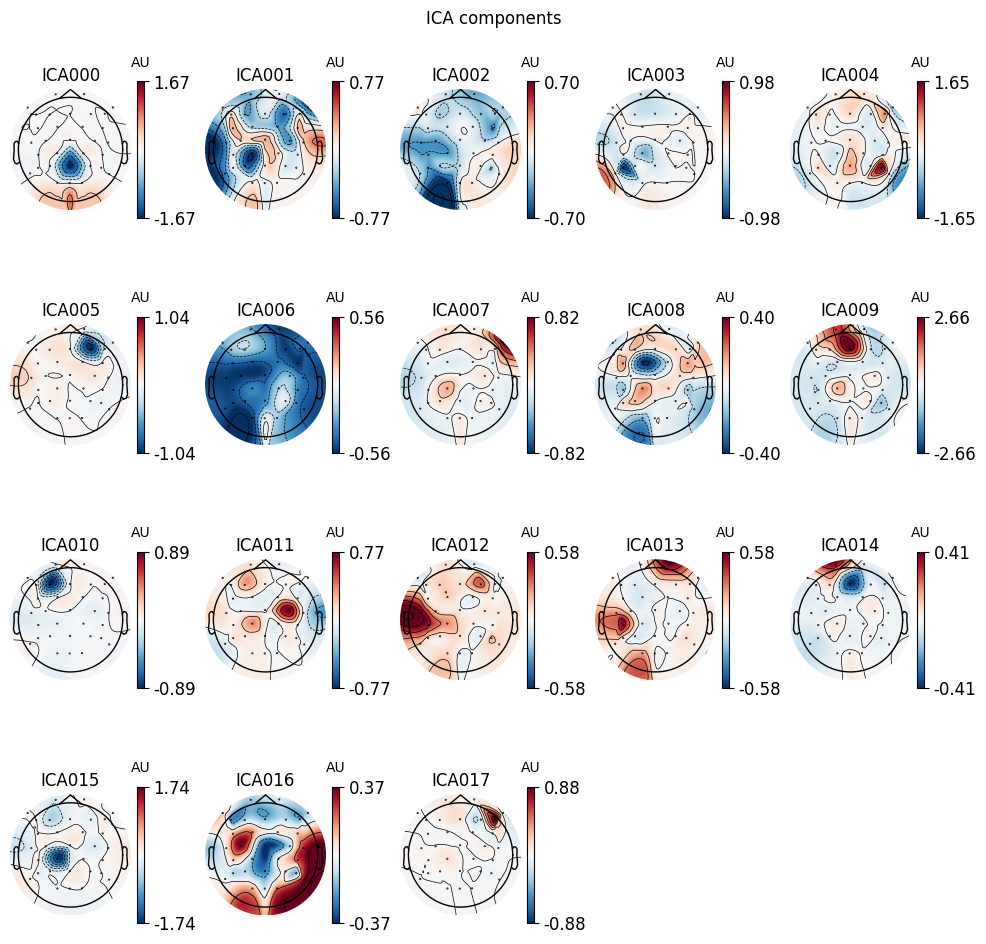

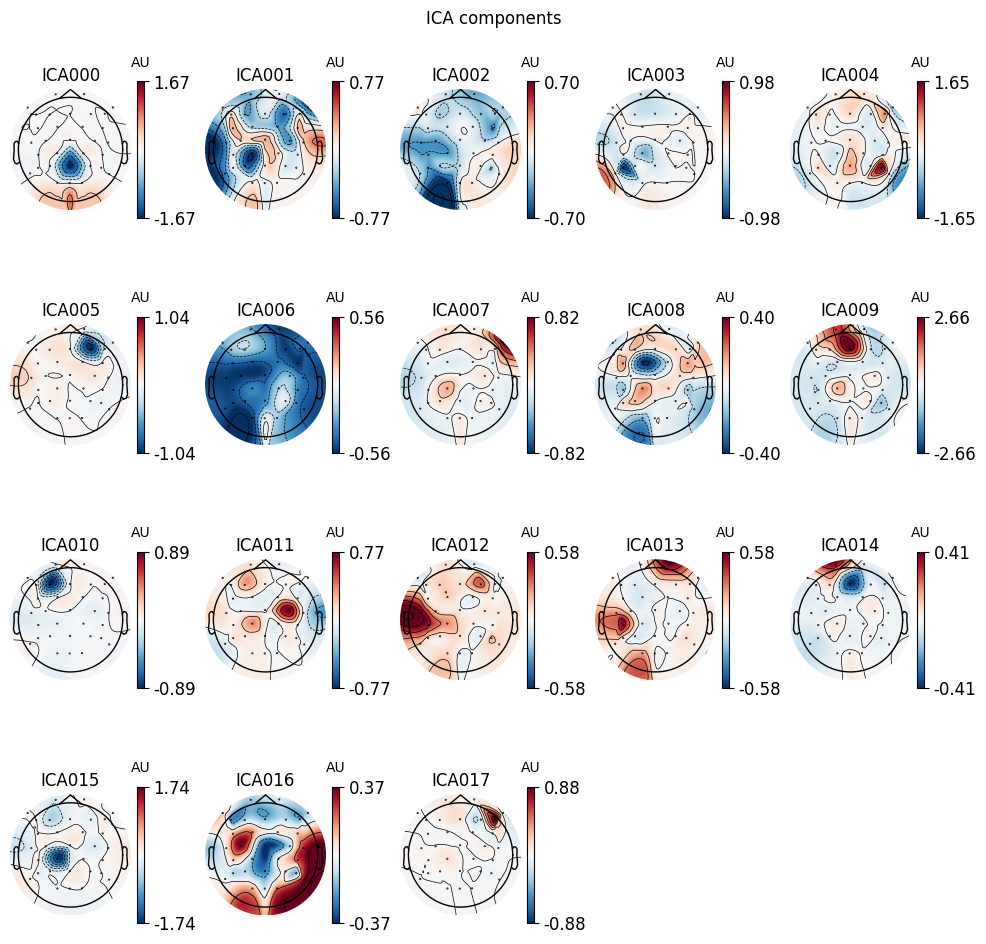

In [41]:
#epochs1 = mne.read_epochs('/content/drive/MyDrive/combined_epochsnew.fif')
method = 'infomax'   # for comparison with EEGLAB try "extended-infomax" here
decim = 10  # we need sufficient statistics, not all time points -> saves time

random_state = 97

n_components = 18
# if float, select n_components by explained variance of PCA
ica = mne.preprocessing.ICA(n_components=n_components, method=method, random_state=random_state,fit_params=dict(extended=True))
print(ica)
reject = dict(eeg=450e-6)
ica.fit(eeg_raw,  decim=decim, reject=reject)
print(ica)
# ica.plot_properties(epochs, picks=0)
%matplotlib inline
# %matplotlib qt
ica.plot_components(colorbar=True)  # Plot all decomposed components

Creating RawArray with float64 data, n_channels=18, n_times=159097
    Range : 0 ... 159096 =      0.000 ...   636.384 secs
Ready.
Using matplotlib as 2D backend.


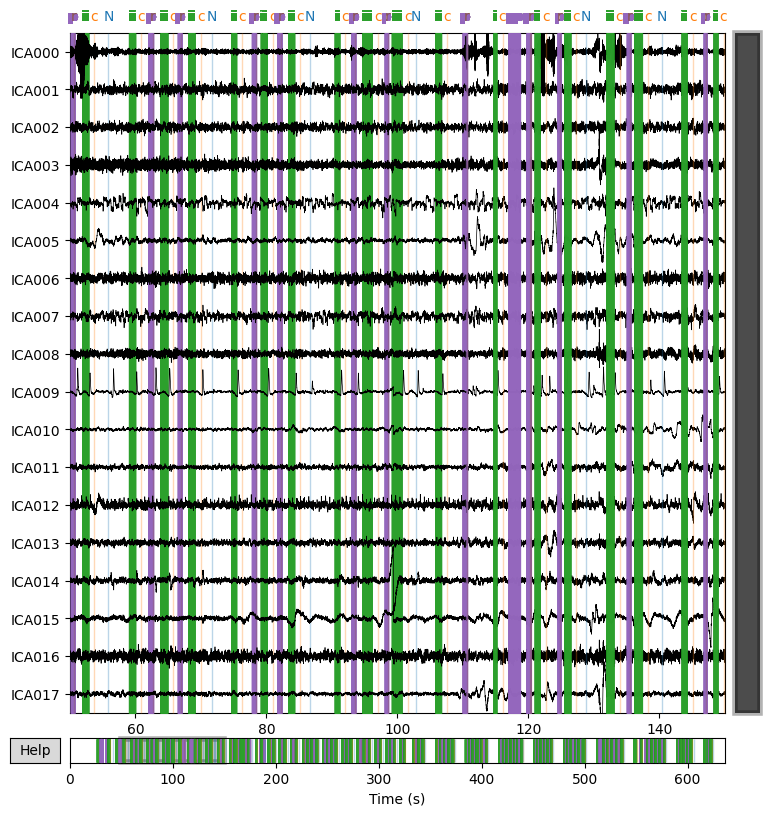

Figure(800x800)


In [42]:
print(ica.plot_sources(eeg_raw,start=50,stop=150))

In [50]:
ic_labels["y_pred_proba"],labels

(array([0.7450533 , 0.9886776 , 0.46138304, 0.68665266, 0.94600976,
        0.36979184, 0.5402886 , 0.5078306 , 0.92436546, 0.9144591 ,
        0.31110498, 0.33719552, 0.9174116 , 0.5638651 , 0.8722872 ,
        0.6788702 , 0.5883984 , 0.86149275], dtype=float32),
 ['brain',
  'other',
  'other',
  'brain',
  'other',
  'other',
  'brain',
  'other',
  'other',
  'other',
  'other',
  'brain',
  'other',
  'other',
  'other',
  'brain',
  'other',
  'other'])

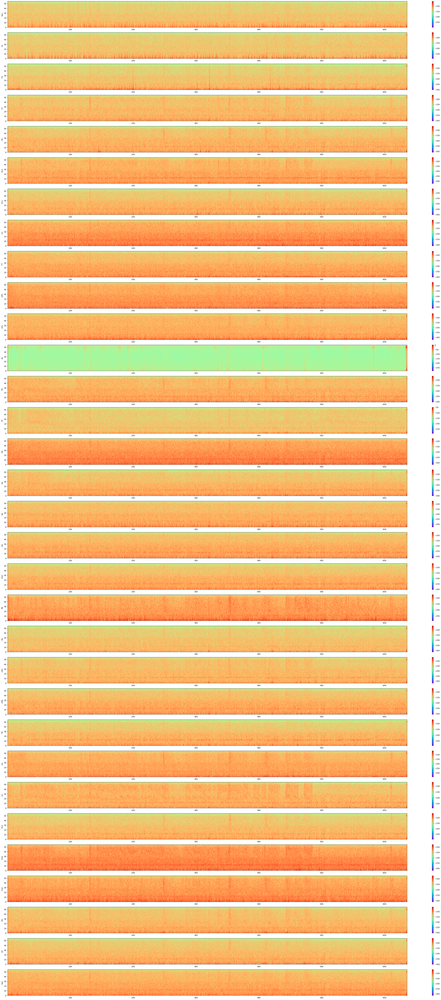

In [77]:
figure = plt.figure(figsize=(48, 96))


for i in range(32):
  ax = figure.add_subplot(32,1,i+1)
  plt.specgram(
    list(eeg_raw._data)[i],
    NFFT=250,
    Fs=250,
    noverlap=125,
    scale_by_freq=True,
    mode='psd',
    cmap='rainbow')
  plt.colorbar()
  plt.ylim(0, 55)
  plt.ylabel(f"{eeg_channels[i]}")

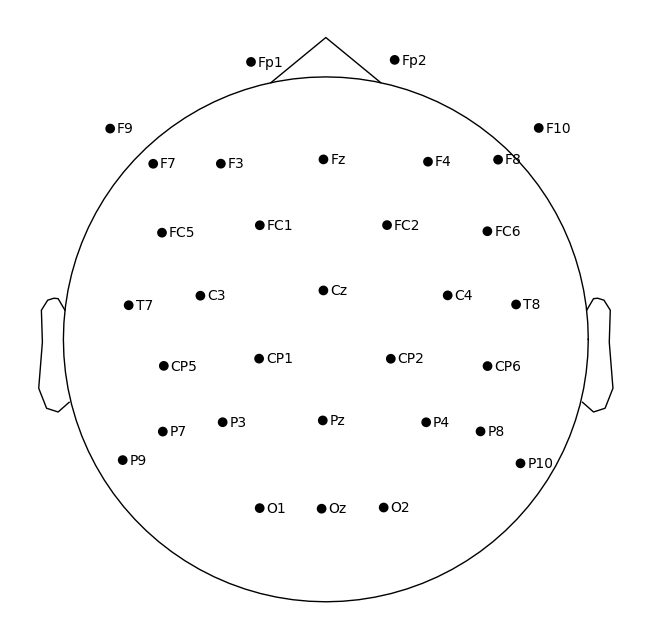

Figure(640x640)


In [79]:
montage = mne.channels.make_standard_montage('standard_1020')
eeg_raw.set_montage(montage)
print(eeg_raw.plot_sensors(show_names = True))

In [80]:
eeg_raw.drop_channels(['O1','Oz', 'O2', 'P3', 'P7', 'P9', 'P4', 'P8', 'P10', 'Pz','Fp1','Fp2','F3', 'F7', 'F9', 'F4', 'F8', 'F10', 'Fz'])

<RawEEGLAB | p1_import.fdt, 13 x 159097 (636.4 s), ~15.8 MiB, data loaded>

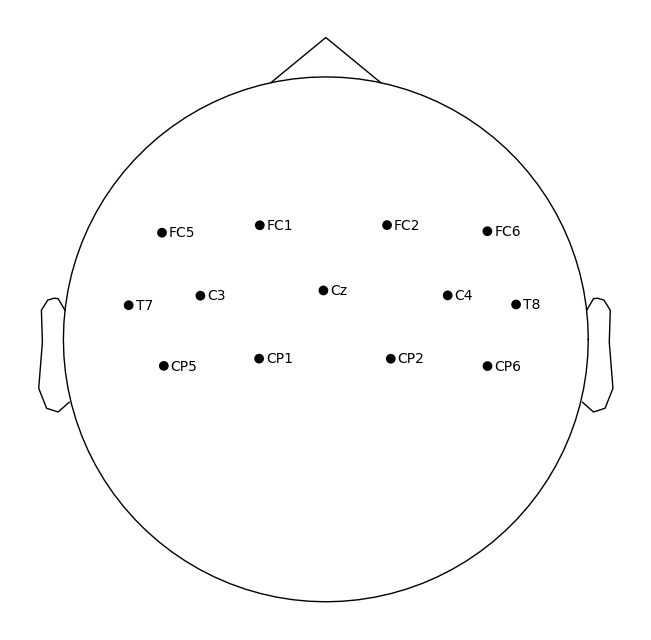

Figure(640x640)


In [81]:
print(eeg_raw.plot_sensors(show_names = True))

<ICA | no decomposition, method: infomax>
Fitting ICA to data using 13 channels (please be patient, this may take a while)
    Rejecting  epoch based on EEG : ['FC5', 'FC1', 'C3', 'T7', 'CP5', 'CP1', 'CP2', 'CP6', 'T8', 'C4', 'Cz', 'FC2', 'FC6']
Artifact detected in [15850, 15900]
Selecting by number: 13 components
Computing Extended Infomax ICA
Fitting ICA took 4.5s.
<ICA | raw data decomposition, method: infomax (fit in 500 iterations on 15850 samples), 13 ICA components (13 PCA components available), channel types: eeg, no sources marked for exclusion>


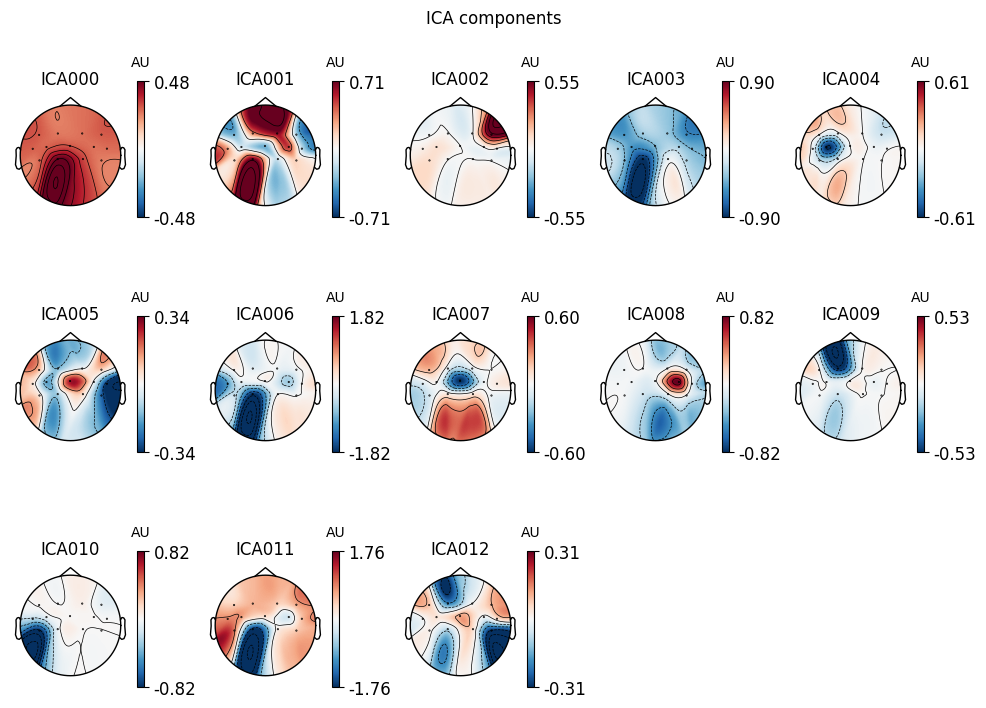

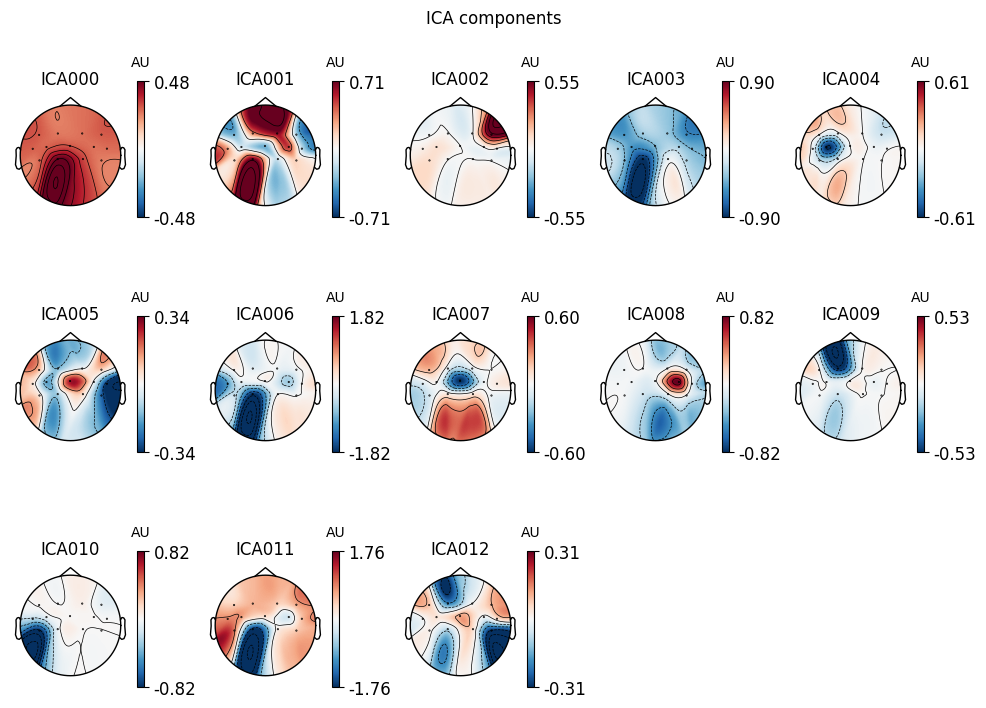

In [54]:
#epochs1 = mne.read_epochs('/content/drive/MyDrive/combined_epochsnew.fif')
method = 'infomax'   # for comparison with EEGLAB try "extended-infomax" here
decim = 10  # we need sufficient statistics, not all time points -> saves time

random_state = 97

n_components = 13
# if float, select n_components by explained variance of PCA
ica = mne.preprocessing.ICA(n_components=n_components, method=method, random_state=random_state,fit_params=dict(extended=True))
print(ica)
reject = dict(eeg=450e-6)
ica.fit(eeg_raw,  decim=decim, reject=reject)
print(ica)
# ica.plot_properties(epochs, picks=0)
%matplotlib inline
# %matplotlib qt
ica.plot_components(colorbar=True)  # Plot all decomposed components

Creating RawArray with float64 data, n_channels=8, n_times=159097
    Range : 0 ... 159096 =      0.000 ...   636.384 secs
Ready.


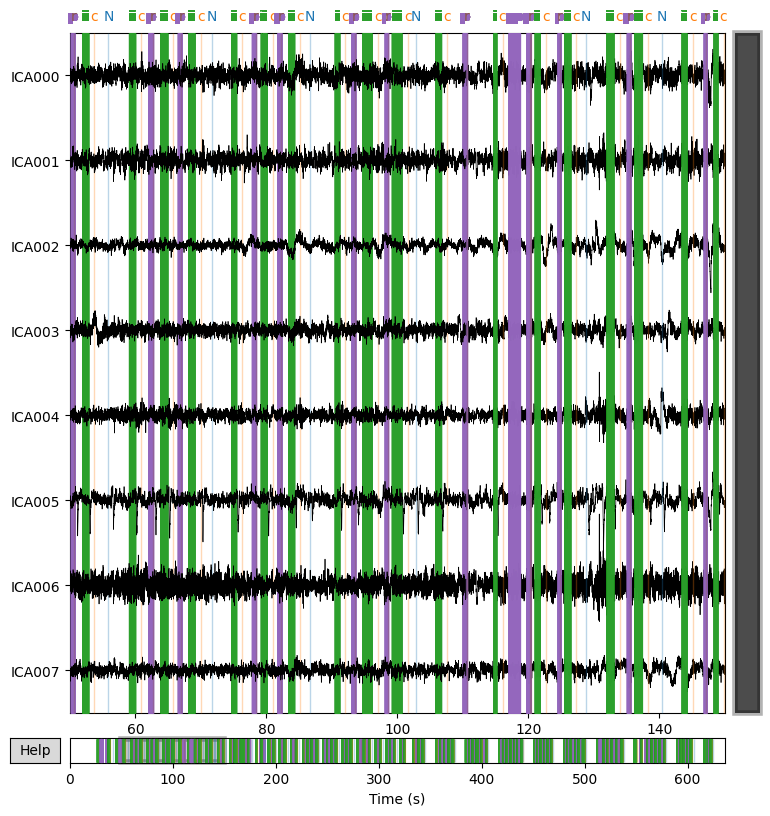

Figure(800x800)


In [53]:
print(ica.plot_sources(eeg_raw,start=50,stop=150))

In [55]:
answer = eeg_raw.compute_psd()

Effective window size : 8.192 (s)


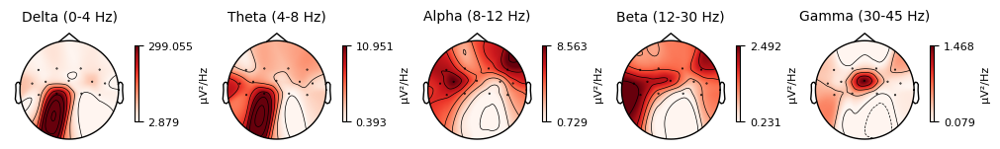

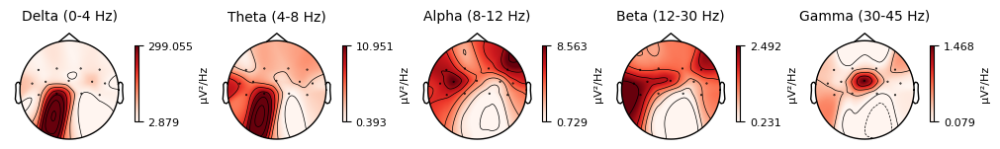

In [56]:
answer.plot_topomap()

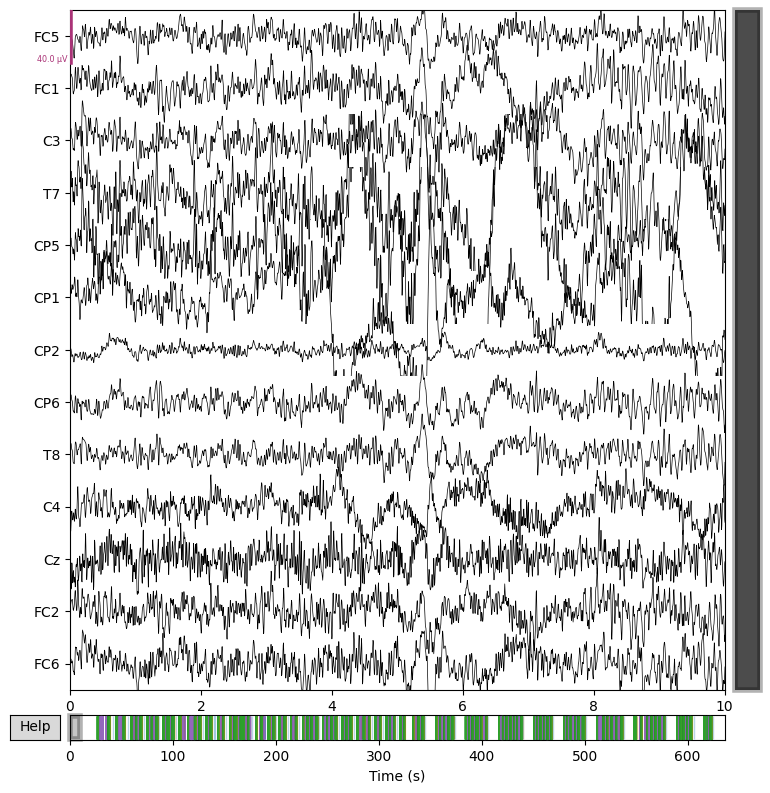

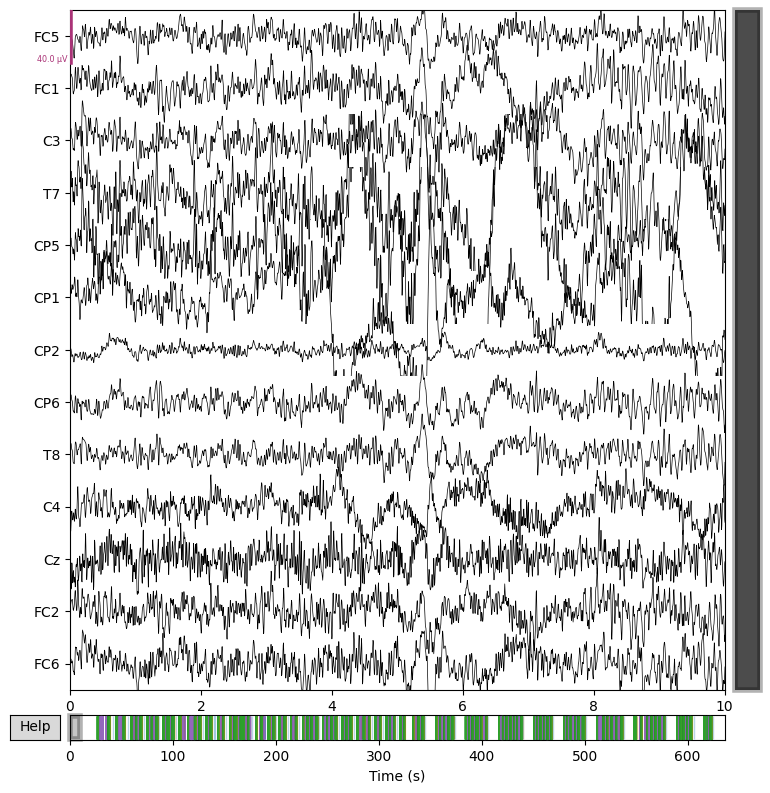

In [57]:
eeg_raw.plot()

In [58]:
events = mne.events_from_annotations(eeg_raw)

Used Annotations descriptions: ['N', 'c', 'i', 'p', 'r']


In [62]:
timeStamps, triggerMap = events

In [64]:
import pandas as pd
dfTime = pd.DataFrame(timeStamps, columns = ['Time Stamp', 'uk', 'Trigger']).drop(['uk'], axis = 1)

In [69]:
dfTime['Time Stamp'][dfTime['Trigger'] == triggerMap['r']]/250

1628      35.516
3690      50.624
4773      62.608
5461      66.976
6421      78.328
          ...   
53576    595.376
54121    598.968
54601    602.024
55253    618.816
55511    621.560
Name: Time Stamp, Length: 78, dtype: float64